In [1]:
import pandas as pd
from rdkit import Chem
import seaborn as sns
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt

In [2]:
tqdm.pandas()


In [3]:
import mols2grid

In [4]:
from rdkit import Chem
from rdkit.Chem import rdChemReactions
from rdkit.Chem import Draw

In [5]:
def count_amides(smiles: str):
    sma = Chem.MolFromSmarts("[NX3][CX3](=[OX1])") # from daylight manual with [#6] removed, allow sulfamides etc
    mol = Chem.MolFromSmiles(smiles)
    matches = mol.GetSubstructMatches(sma)
    return len(matches)

In [6]:
from rdkit import Chem
from rdkit.Chem import rdChemReactions
import pandas as pd


def split_amide(smiles: str):

    mol = Chem.MolFromSmiles(smiles)
    reaction_smarts = "[C:1](=[O:2])[N:3]>>[C:1](=[O:2])[OX2H1].[N:3]"
    reaction = rdChemReactions.ReactionFromSmarts(reaction_smarts)
    products = reaction.RunReactants((mol,))
    
    for product_set in products:
        frags = []

        for fragment in product_set:
            frags.append(fragment)
    
    if len(frags) == 2:
        # only want actual disconnections
        print(f"frag1: {Chem.MolToSmiles(frags[0])}")
        print(f"frag2: {Chem.MolToSmiles(frags[1])}")
        return frags
        
    else:
        return pd.NA
        
        

In [7]:

def split_amide_to_smiles(smiles: str):
    mol = Chem.MolFromSmiles(smiles)
    reaction_smarts = "[C:1](=[O:2])[N:3]>>[C:1](=[O:2])[OX2H1].[N:3]"
    reaction = rdChemReactions.ReactionFromSmarts(reaction_smarts)
    products = reaction.RunReactants((mol,))

    if len(products) == 0:
        return pd.NA
        
    for product_set in products:
        frags = []
        for fragment in product_set:
            frags.append(fragment)
    
    
    if len(frags) == 2:
        # only want actual disconnections
        # print(f"frag1: {Chem.MolToSmiles(frags[0])}")
        # print(f"frag2: {Chem.MolToSmiles(frags[1])}")
        return Chem.MolToSmiles(frags[0]),  Chem.MolToSmiles(frags[1])
        
    else:
        return pd.NA


In [8]:
def draw(frags):
    img = Draw.MolsToGridImage(frags)
    return img

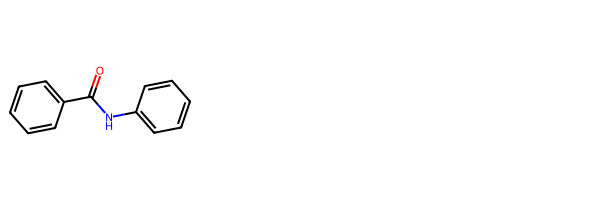

In [9]:
draw([Chem.MolFromSmiles("O=C(NC1=CC=CC=C1)C1=CC=CC=C1")])

In [10]:
count_amides("O=C(NC1=CC=CC=C1)C1=CC=CC=C1")

1

In [11]:
fragments = split_amide("O=C(NC1=CC=CC=C1)C1=CC=CC=C1")

frag1: O=C(O)c1ccccc1
frag2: Nc1ccccc1


In [12]:
fragments = split_amide("O=C(NC1=CC=CC=C1)C1=CC=CC=C1")

frag1: O=C(O)c1ccccc1
frag2: Nc1ccccc1


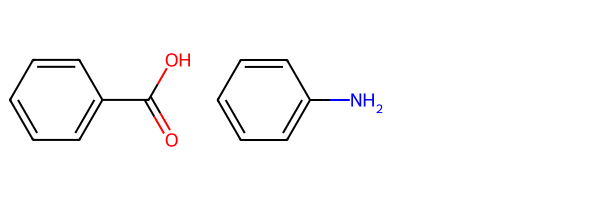

In [13]:
draw(fragments)

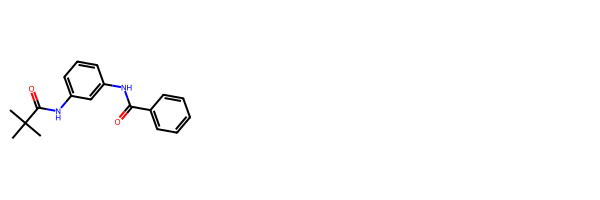

In [14]:
draw([Chem.MolFromSmiles("CC(C)(C)C(=O)NC1=CC=CC(NC(=O)C2=CC=CC=C2)=C1")])

In [15]:
count_amides("CC(C)(C)C(=O)NC1=CC=CC(NC(=O)C2=CC=CC=C2)=C1")

2

In [16]:
fragments = split_amide("CC(C)(C)C(=O)NC1=CC=CC(NC(=O)C2=CC=CC=C2)=C1")

frag1: O=C(O)c1ccccc1
frag2: CC(C)(C)C(=O)Nc1cccc(N)c1


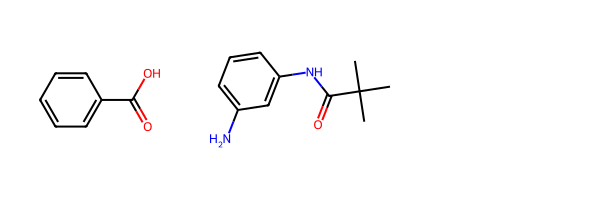

In [17]:
draw(fragments)

In [18]:
smiles_list = ["CC(=O)NC1=CC=C(C=C1)O", "CC(C)C1CC(CN1C(=O)C2CCC(=O)N(C2)C(=O)O)C(=O)O", "CC1(C)S[C@H]2[C@H](NC(=O)C(NC(=O)C3=CC=CC=C3)C2=O)C1N", "CCN(CC)C(=O)C1=CC=CC=C1N", "CC(=O)NC1=CC=CC2=C1C=CC(=C2)C(C3=CC=CC=C3Cl)(C(=O)O)C"]

In [19]:
for s in smiles_list:
    draw(split_amide(s))

frag1: CC(=O)O
frag2: Nc1ccc(O)cc1
frag1: O=C(O)O
frag2: CC(C)C1CC(C(=O)O)CN1C(=O)C1CCC(=O)NC1
frag1: O=C(O)c1ccccc1
frag2: CC1(C)S[C@@H]2C(=O)C(N)C(=O)N[C@@H]2C1N
frag1: Nc1ccccc1C(=O)O
frag2: CCNCC
frag1: CC(=O)O
frag2: CC(C(=O)O)(c1ccc2c(N)cccc2c1)c1ccccc1Cl


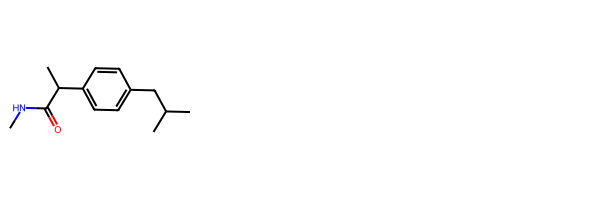

In [20]:
draw([Chem.MolFromSmiles("CC(C)CC1=CC=C(C=C1)C(C)C(=O)NC")])

frag1: CC(C)Cc1ccc(C(C)C(=O)O)cc1
frag2: CN


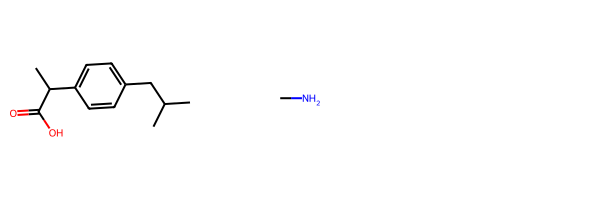

In [21]:
draw(split_amide("CC(C)CC1=CC=C(C=C1)C(C)C(=O)NC"))

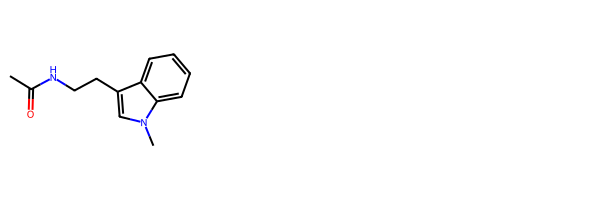

In [22]:
draw([Chem.MolFromSmiles("CC(=O)NCCC1=CN(C2=CC=CC=C12)C")])

frag1: CC(=O)O
frag2: Cn1cc(CCN)c2ccccc21


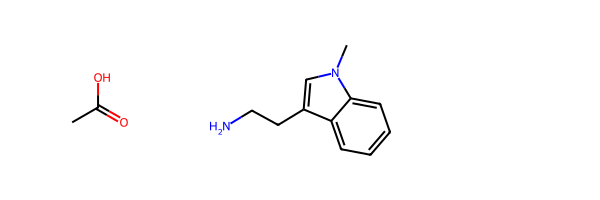

In [23]:
draw(split_amide("CC(=O)NCCC1=CN(C2=CC=CC=C12)C"))

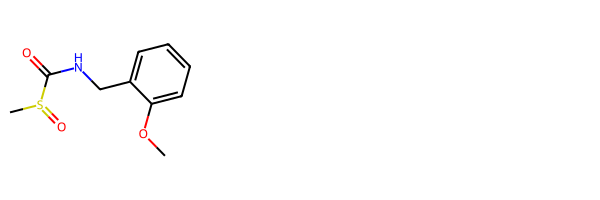

In [24]:
draw([Chem.MolFromSmiles("CS(=O)C(=O)NCC1=CC=CC=C1OC")])

In [25]:
count_amides("CS(=O)C(=O)NCC1=CC=CC=C1OC")

1

frag1: CS(=O)C(=O)O
frag2: COc1ccccc1CN


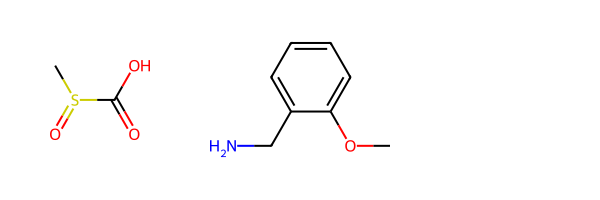

In [26]:
draw(split_amide("CS(=O)C(=O)NCC1=CC=CC=C1OC"))

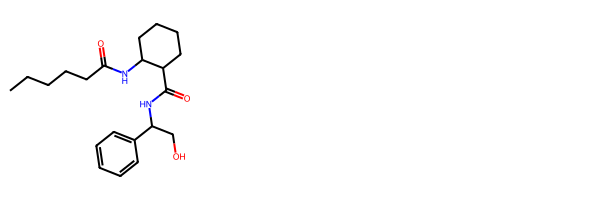

In [27]:
draw([Chem.MolFromSmiles("CCCCCC(=O)NC1CCCCC1C(=O)NC(CO)C1=CC=CC=C1")])

In [28]:
count_amides("CCCCCC(=O)NC1CCCCC1C(=O)NC(CO)C1=CC=CC=C1")

2

frag1: CCCCCC(=O)NC1CCCCC1C(=O)O
frag2: NC(CO)c1ccccc1


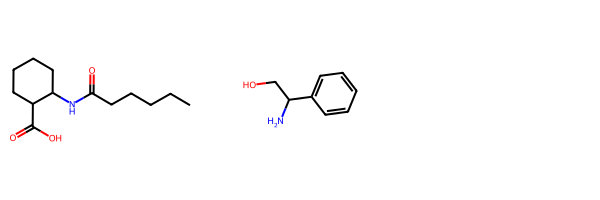

In [29]:
draw(split_amide("CCCCCC(=O)NC1CCCCC1C(=O)NC(CO)C1=CC=CC=C1"))

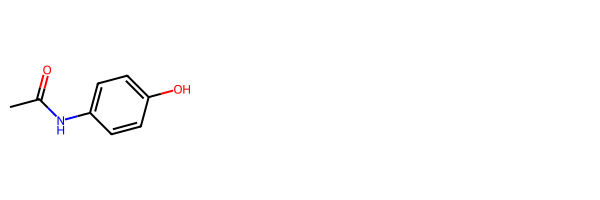

In [30]:
draw([Chem.MolFromSmiles("CC(=O)NC1=CC=C(C=C1)O")])

frag1: CC(=O)O
frag2: Nc1ccc(O)cc1


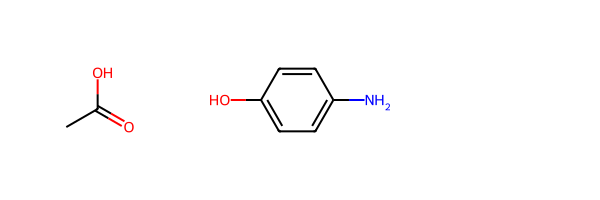

In [31]:
draw(split_amide("CC(=O)NC1=CC=C(C=C1)O"))

In [32]:
all_actives = pd.read_csv("./final/actives_final.csv")

In [33]:
from rdkit.Chem import rdMolDescriptors


In [34]:
def smi_to_MW(smiles):
    try:
        mol = Chem.MolFromSmiles(smiles)
        return rdMolDescriptors.CalcExactMolWt(mol)
    except:
        return pd.NA

In [35]:
all_actives["MW"] = all_actives["CANONICAL_SMILES"].apply(lambda x: smi_to_MW(x))

In [36]:
all_actives

,CANONICAL_SMILES,INCHIKEY,active,common_name,action_type,pChEMBL mean,pChEMBL std,appears_in_N_ChEMBL_assays,appears_in_N_datasets,dataset_ChEMBL_curated,dataset_carbon-mangels_2011,dataset_ncats_adme_aid1645841,dataset_novartis_2024,dataset_veith_2009,inclusion_score,MW
0,CC(=O)N1CCN(c2ccc(OCC3COC(Cn4ccnc4)(c4ccc(Cl)c...,XMAYWYJOQHXEEK-UHFFFAOYSA-N,True,KETOCONAZOLE,unknown,7.013500,0.618796,21.0,1,True,False,False,False,False,22.0,530.148761
1,CCC1C(=O)OC[C@H]1Cc1cncn1C,QCHFTSOMWOSFHM-HNHGDDPOSA-N,True,SALAGEN,unknown,5.052941,0.285302,17.0,1,True,False,False,False,False,18.0,208.121178
2,Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1,VNFPBHJOKIVQEB-UHFFFAOYSA-N,True,CLOTRIMAZOLE,unknown,7.237692,0.358798,14.0,3,True,True,True,False,False,17.0,344.108026
3,CNCCCC12CCC(c3ccccc31)c1ccccc12,QSLMDECMDJKHMQ-UHFFFAOYSA-N,True,MAPROTILINE HYDROCHLORIDE,unknown,5.473846,0.281470,13.0,3,True,False,True,False,True,16.0,277.183050
4,Clc1ccc(COC(Cn2ccnc2)c2ccc(Cl)cc2Cl)c(Cl)c1,BYBLEWFAAKGYCD-UHFFFAOYSA-N,True,MICONAZOLE NITRATE,unknown,6.060000,0.608590,12.0,3,True,False,True,False,True,15.0,413.986024
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10061,COc1ccc(C(=O)Nc2ccc3oc(-c4ccc(OC)cc4)nc3c2)cc1,AZGZJIGRQLPADH-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,374.126657
10062,COc1ccc(-c2noc(CCCC(=O)Nc3cccc(Cl)c3C)n2)cc1,SXIDKMVLEKDAIV-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,385.119319
10063,Cc1ccc(C)c(Nc2nc3nonc3nc2Nc2cccc(C)c2C)c1,ADSUIKWZHHALJL-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,360.169859
10064,COc1ccc(CNC(=O)c2nc(SCc3ccccc3F)ncc2Cl)cc1,JADAEYAQPRSFRN-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,417.071404


In [37]:
mols2grid.display(all_actives, smiles_col="CANONICAL_SMILES")

MolGridWidget()

<Axes: xlabel='MW', ylabel='Count'>

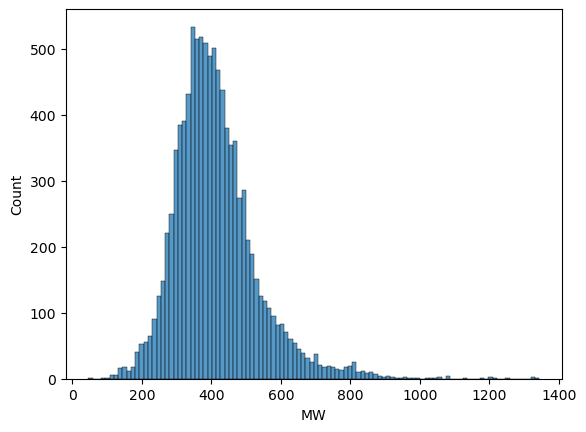

In [38]:
sns.histplot(data =all_actives, x="MW")

In [39]:
all_actives["n_amides"] = all_actives["CANONICAL_SMILES"].progress_apply(lambda x: count_amides(x))

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10066/10066 [00:01<00:00, 8940.12it/s]


In [40]:
all_actives["n_amides"].value_counts()

n_amides
0     5297
1     3147
2     1144
3      253
4      104
5       83
6       30
11       7
9        1
Name: count, dtype: int64

In [41]:
all_actives["products"] = all_actives["CANONICAL_SMILES"].progress_apply(lambda x: split_amide_to_smiles(x))

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10066/10066 [00:01<00:00, 5343.46it/s]


In [42]:
all_actives["carboxy"] = all_actives["products"].apply(lambda x: x[0] if x is not pd.NA else pd.NA)

In [43]:
all_actives["amine"] = all_actives["products"].apply(lambda x: x[1] if x is not pd.NA else pd.NA)

In [44]:
all_actives

,CANONICAL_SMILES,INCHIKEY,active,common_name,action_type,pChEMBL mean,pChEMBL std,appears_in_N_ChEMBL_assays,appears_in_N_datasets,dataset_ChEMBL_curated,dataset_carbon-mangels_2011,dataset_ncats_adme_aid1645841,dataset_novartis_2024,dataset_veith_2009,inclusion_score,MW,n_amides,products,carboxy,amine
0,CC(=O)N1CCN(c2ccc(OCC3COC(Cn4ccnc4)(c4ccc(Cl)c...,XMAYWYJOQHXEEK-UHFFFAOYSA-N,True,KETOCONAZOLE,unknown,7.013500,0.618796,21.0,1,True,False,False,False,False,22.0,530.148761,1,"(CC(=O)O, Clc1ccc(C2(Cn3ccnc3)OCC(COc3ccc(N4CC...",CC(=O)O,Clc1ccc(C2(Cn3ccnc3)OCC(COc3ccc(N4CCNCC4)cc3)O...
1,CCC1C(=O)OC[C@H]1Cc1cncn1C,QCHFTSOMWOSFHM-HNHGDDPOSA-N,True,SALAGEN,unknown,5.052941,0.285302,17.0,1,True,False,False,False,False,18.0,208.121178,0,<NA>,<NA>,<NA>
2,Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1,VNFPBHJOKIVQEB-UHFFFAOYSA-N,True,CLOTRIMAZOLE,unknown,7.237692,0.358798,14.0,3,True,True,True,False,False,17.0,344.108026,0,<NA>,<NA>,<NA>
3,CNCCCC12CCC(c3ccccc31)c1ccccc12,QSLMDECMDJKHMQ-UHFFFAOYSA-N,True,MAPROTILINE HYDROCHLORIDE,unknown,5.473846,0.281470,13.0,3,True,False,True,False,True,16.0,277.183050,0,<NA>,<NA>,<NA>
4,Clc1ccc(COC(Cn2ccnc2)c2ccc(Cl)cc2Cl)c(Cl)c1,BYBLEWFAAKGYCD-UHFFFAOYSA-N,True,MICONAZOLE NITRATE,unknown,6.060000,0.608590,12.0,3,True,False,True,False,True,15.0,413.986024,0,<NA>,<NA>,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10061,COc1ccc(C(=O)Nc2ccc3oc(-c4ccc(OC)cc4)nc3c2)cc1,AZGZJIGRQLPADH-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,374.126657,1,"(COc1ccc(C(=O)O)cc1, COc1ccc(-c2nc3cc(N)ccc3o2...",COc1ccc(C(=O)O)cc1,COc1ccc(-c2nc3cc(N)ccc3o2)cc1
10062,COc1ccc(-c2noc(CCCC(=O)Nc3cccc(Cl)c3C)n2)cc1,SXIDKMVLEKDAIV-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,385.119319,1,"(COc1ccc(-c2noc(CCCC(=O)O)n2)cc1, Cc1c(N)cccc1Cl)",COc1ccc(-c2noc(CCCC(=O)O)n2)cc1,Cc1c(N)cccc1Cl
10063,Cc1ccc(C)c(Nc2nc3nonc3nc2Nc2cccc(C)c2C)c1,ADSUIKWZHHALJL-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,360.169859,0,<NA>,<NA>,<NA>
10064,COc1ccc(CNC(=O)c2nc(SCc3ccccc3F)ncc2Cl)cc1,JADAEYAQPRSFRN-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,417.071404,1,"(O=C(O)c1nc(SCc2ccccc2F)ncc1Cl, COc1ccc(CN)cc1)",O=C(O)c1nc(SCc2ccccc2F)ncc1Cl,COc1ccc(CN)cc1


In [45]:
has_disconnection = all_actives[all_actives["products"].notna()]
has_disconnection

,CANONICAL_SMILES,INCHIKEY,active,common_name,action_type,pChEMBL mean,pChEMBL std,appears_in_N_ChEMBL_assays,appears_in_N_datasets,dataset_ChEMBL_curated,dataset_carbon-mangels_2011,dataset_ncats_adme_aid1645841,dataset_novartis_2024,dataset_veith_2009,inclusion_score,MW,n_amides,products,carboxy,amine
0,CC(=O)N1CCN(c2ccc(OCC3COC(Cn4ccnc4)(c4ccc(Cl)c...,XMAYWYJOQHXEEK-UHFFFAOYSA-N,True,KETOCONAZOLE,unknown,7.0135,0.618796,21.0,1,True,False,False,False,False,22.0,530.148761,1,"(CC(=O)O, Clc1ccc(C2(Cn3ccnc3)OCC(COc3ccc(N4CC...",CC(=O)O,Clc1ccc(C2(Cn3ccnc3)OCC(COc3ccc(N4CCNCC4)cc3)O...
5,CN(C(=O)Cc1ccc(Cl)c(Cl)c1)[C@@H]1CCCC[C@H]1N1C...,VQLPLYSROCPWFF-QZTJIDSGSA-N,True,U-50488 METHANE SULFONATE,unknown,5.1500,0.173205,12.0,2,True,False,False,False,True,14.0,368.142219,1,"(O=C(O)Cc1ccc(Cl)c(Cl)c1, CN[C@@H]1CCCC[C@H]1N...",O=C(O)Cc1ccc(Cl)c(Cl)c1,CN[C@@H]1CCCC[C@H]1N1CCCC1
12,CC(C)CC1C(=O)N2CCC[C@@H]2[C@]2(O)O[C@](NC(=O)C...,OZVBMTJYIDMWIL-YKJQSKOWSA-N,True,NaN,unknown,6.1000,0.086603,9.0,3,True,False,False,True,True,12.0,653.221281,3,(CC(C)CCC(=O)N1CCC[C@@H]1C(O)O[C@@](NC(=O)C1C=...,CC(C)CCC(=O)N1CCC[C@@H]1C(O)O[C@@](NC(=O)C1C=C...,CC(C)CC1N[C@@](O)(OC(NC(=O)C2C=C3c4cccc5[nH]c(...
18,COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)NC2...,ZNNLBTZKUZBEKO-UHFFFAOYSA-N,True,GLYBURIDE,unknown,5.2500,0.207020,8.0,3,True,True,True,False,False,11.0,493.143820,3,(COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)O)...,COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)O)cc1,NC1CCCCC1
24,COc1cc(CNC(=O)CCCC/C=C\C(C)C)ccc1O,YKPUWZUDDOIDPM-VURMDHGXSA-N,True,ZUCAPSAICIN,unknown,5.3000,0.150000,9.0,2,True,False,False,True,False,11.0,305.199094,1,"(CC(C)/C=C\CCCCC(=O)O, COc1cc(CN)ccc1O)",CC(C)/C=C\CCCCC(=O)O,COc1cc(CN)ccc1O
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10060,COc1ccc(CNC(=O)Nc2ccc3c(c2)N(C)C(=O)c2ccccc2S3...,BKMURWCUGPEUFS-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,449.140927,3,(COc1ccc(CNC(=O)Nc2ccc(Sc3ccccc3C(=O)O)cc2)cc1...,COc1ccc(CNC(=O)Nc2ccc(Sc3ccccc3C(=O)O)cc2)cc1OC,CNc1cc(NC(=O)NCc2ccc(OC)c(OC)c2)ccc1Sc1ccccc1
10061,COc1ccc(C(=O)Nc2ccc3oc(-c4ccc(OC)cc4)nc3c2)cc1,AZGZJIGRQLPADH-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,374.126657,1,"(COc1ccc(C(=O)O)cc1, COc1ccc(-c2nc3cc(N)ccc3o2...",COc1ccc(C(=O)O)cc1,COc1ccc(-c2nc3cc(N)ccc3o2)cc1
10062,COc1ccc(-c2noc(CCCC(=O)Nc3cccc(Cl)c3C)n2)cc1,SXIDKMVLEKDAIV-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,385.119319,1,"(COc1ccc(-c2noc(CCCC(=O)O)n2)cc1, Cc1c(N)cccc1Cl)",COc1ccc(-c2noc(CCCC(=O)O)n2)cc1,Cc1c(N)cccc1Cl
10064,COc1ccc(CNC(=O)c2nc(SCc3ccccc3F)ncc2Cl)cc1,JADAEYAQPRSFRN-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,417.071404,1,"(O=C(O)c1nc(SCc2ccccc2F)ncc1Cl, COc1ccc(CN)cc1)",O=C(O)c1nc(SCc2ccccc2F)ncc1Cl,COc1ccc(CN)cc1


In [49]:
has_disconnection.to_csv("./final/with_amide_disconnect.csv", index=False)

In [48]:
has_disconnection

,CANONICAL_SMILES,INCHIKEY,active,common_name,action_type,pChEMBL mean,pChEMBL std,appears_in_N_ChEMBL_assays,appears_in_N_datasets,dataset_ChEMBL_curated,dataset_carbon-mangels_2011,dataset_ncats_adme_aid1645841,dataset_novartis_2024,dataset_veith_2009,inclusion_score,MW,n_amides,products,carboxy,amine
0,CC(=O)N1CCN(c2ccc(OCC3COC(Cn4ccnc4)(c4ccc(Cl)c...,XMAYWYJOQHXEEK-UHFFFAOYSA-N,True,KETOCONAZOLE,unknown,7.0135,0.618796,21.0,1,True,False,False,False,False,22.0,530.148761,1,"(CC(=O)O, Clc1ccc(C2(Cn3ccnc3)OCC(COc3ccc(N4CC...",CC(=O)O,Clc1ccc(C2(Cn3ccnc3)OCC(COc3ccc(N4CCNCC4)cc3)O...
5,CN(C(=O)Cc1ccc(Cl)c(Cl)c1)[C@@H]1CCCC[C@H]1N1C...,VQLPLYSROCPWFF-QZTJIDSGSA-N,True,U-50488 METHANE SULFONATE,unknown,5.1500,0.173205,12.0,2,True,False,False,False,True,14.0,368.142219,1,"(O=C(O)Cc1ccc(Cl)c(Cl)c1, CN[C@@H]1CCCC[C@H]1N...",O=C(O)Cc1ccc(Cl)c(Cl)c1,CN[C@@H]1CCCC[C@H]1N1CCCC1
12,CC(C)CC1C(=O)N2CCC[C@@H]2[C@]2(O)O[C@](NC(=O)C...,OZVBMTJYIDMWIL-YKJQSKOWSA-N,True,NaN,unknown,6.1000,0.086603,9.0,3,True,False,False,True,True,12.0,653.221281,3,(CC(C)CCC(=O)N1CCC[C@@H]1C(O)O[C@@](NC(=O)C1C=...,CC(C)CCC(=O)N1CCC[C@@H]1C(O)O[C@@](NC(=O)C1C=C...,CC(C)CC1N[C@@](O)(OC(NC(=O)C2C=C3c4cccc5[nH]c(...
18,COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)NC2...,ZNNLBTZKUZBEKO-UHFFFAOYSA-N,True,GLYBURIDE,unknown,5.2500,0.207020,8.0,3,True,True,True,False,False,11.0,493.143820,3,(COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)O)...,COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)O)cc1,NC1CCCCC1
24,COc1cc(CNC(=O)CCCC/C=C\C(C)C)ccc1O,YKPUWZUDDOIDPM-VURMDHGXSA-N,True,ZUCAPSAICIN,unknown,5.3000,0.150000,9.0,2,True,False,False,True,False,11.0,305.199094,1,"(CC(C)/C=C\CCCCC(=O)O, COc1cc(CN)ccc1O)",CC(C)/C=C\CCCCC(=O)O,COc1cc(CN)ccc1O
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10060,COc1ccc(CNC(=O)Nc2ccc3c(c2)N(C)C(=O)c2ccccc2S3...,BKMURWCUGPEUFS-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,449.140927,3,(COc1ccc(CNC(=O)Nc2ccc(Sc3ccccc3C(=O)O)cc2)cc1...,COc1ccc(CNC(=O)Nc2ccc(Sc3ccccc3C(=O)O)cc2)cc1OC,CNc1cc(NC(=O)NCc2ccc(OC)c(OC)c2)ccc1Sc1ccccc1
10061,COc1ccc(C(=O)Nc2ccc3oc(-c4ccc(OC)cc4)nc3c2)cc1,AZGZJIGRQLPADH-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,374.126657,1,"(COc1ccc(C(=O)O)cc1, COc1ccc(-c2nc3cc(N)ccc3o2...",COc1ccc(C(=O)O)cc1,COc1ccc(-c2nc3cc(N)ccc3o2)cc1
10062,COc1ccc(-c2noc(CCCC(=O)Nc3cccc(Cl)c3C)n2)cc1,SXIDKMVLEKDAIV-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,385.119319,1,"(COc1ccc(-c2noc(CCCC(=O)O)n2)cc1, Cc1c(N)cccc1Cl)",COc1ccc(-c2noc(CCCC(=O)O)n2)cc1,Cc1c(N)cccc1Cl
10064,COc1ccc(CNC(=O)c2nc(SCc3ccccc3F)ncc2Cl)cc1,JADAEYAQPRSFRN-UHFFFAOYSA-N,True,NaN,inhibitor,NaN,NaN,NaN,1,False,False,True,False,False,1.0,417.071404,1,"(O=C(O)c1nc(SCc2ccccc2F)ncc1Cl, COc1ccc(CN)cc1)",O=C(O)c1nc(SCc2ccccc2F)ncc1Cl,COc1ccc(CN)cc1
